### Teofilus San Prasetya

# Multiclass Batik Image Classification Using VGG16 and MobileNetV2 Architectures: Model Performance Comparison

**The dataset used in this project consists of a collection of batik images categorized into three classes. Each class contains a number of images reflecting different batik motifs.**

In [27]:
import cv2
import os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import tensorflow as tf
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.layers import Input, Conv2D, Dense, Flatten, Dropout, MaxPooling2D, BatchNormalization, GlobalAveragePooling2D
from tensorflow.keras.callbacks import EarlyStopping, LearningRateScheduler, ReduceLROnPlateau
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing.image import load_img

import warnings
warnings.filterwarnings('ignore')


### Selecting 3 classes of batik files from the 20 available batik classes in the dataset

In [28]:
# Prepare lists to store image paths and labels
input_path = []
labels = []

for class_name in os.listdir("/kaggle/input/indonesia-batik-motifs"):
    for img_name in os.listdir(os.path.join("/kaggle/input/indonesia-batik-motifs", class_name)):
        if class_name == 'batik-keraton':
            labels.append(0)
        elif class_name == 'batik-sekar':
            labels.append(1)
        elif class_name == 'batik-sidoluhur':
            labels.append(2)
        input_path.append(os.path.join("/kaggle/input/indonesia-batik-motifs", class_name, img_name))

print(input_path[0], labels[0])

/kaggle/input/indonesia-batik-motifs/batik-sidoluhur/45.jpg 2


In [29]:
# Create a DataFrame from input_path and labels
df = pd.DataFrame()
df['images'] = input_path
df['label'] = labels

# Shuffle the rows and reset the index
df = df.sample(frac=1).reset_index(drop=True)

print(df.head())

print("Total number of images:", len(df))


                                              images  label
0  /kaggle/input/indonesia-batik-motifs/batik-sek...      1
1  /kaggle/input/indonesia-batik-motifs/batik-sid...      2
2  /kaggle/input/indonesia-batik-motifs/batik-sek...      1
3  /kaggle/input/indonesia-batik-motifs/batik-ker...      0
4  /kaggle/input/indonesia-batik-motifs/batik-sek...      1
Total number of images: 147


### Image Data Analysis

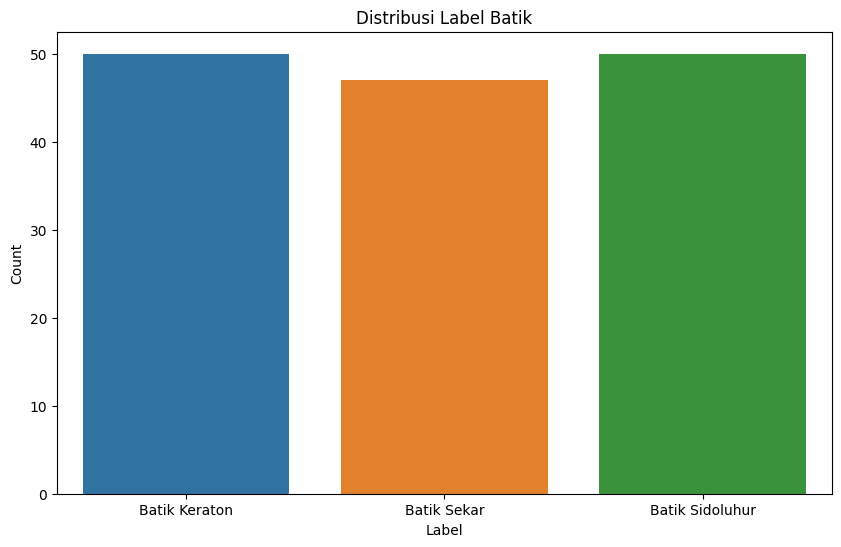

In [30]:
# Plot the number of labels
plt.figure(figsize=(10, 6))
sns.countplot(x='label', data=df)
plt.title('Distribusi Label Batik')
plt.xlabel('Label')
plt.ylabel('Count')
plt.xticks(ticks=[0, 1, 2], labels=['Batik Keraton', 'Batik Sekar', 'Batik Sidoluhur'])
plt.show()


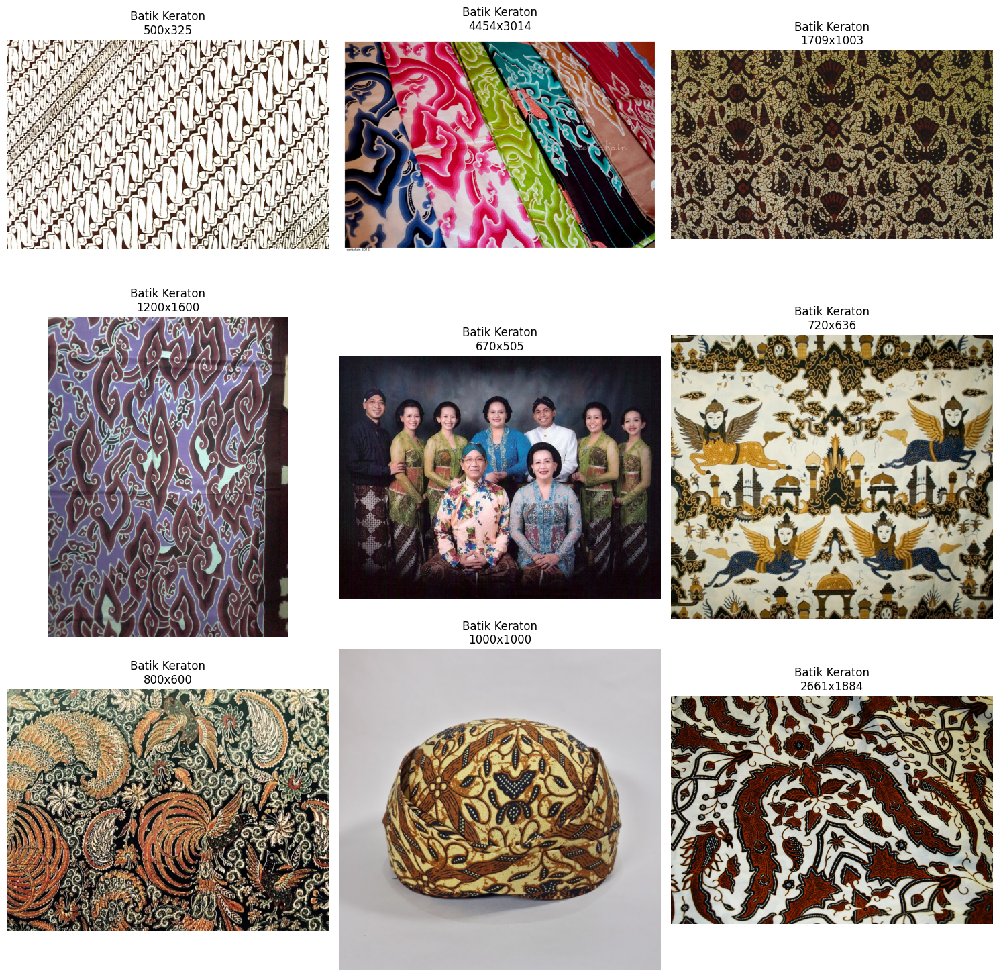

In [31]:
# Function to get image dimensions
def get_image_dimensions(image_path):
    img = load_img(image_path)
    return img.size 

# Add dimensions to the dataframe
df['dimensions'] = df['images'].apply(get_image_dimensions)

# Function to display an image grid for a specific label with dimensions
def display_images_with_dimensions(label, title):
    plt.figure(figsize=(15, 15)) # Adjust size for a 3x3 grid
    temp = df[df['label'] == label]['images'].sample(9).tolist()  # Take 9 random image samples
    for index, file in enumerate(temp):
        plt.subplot(3, 3, index + 1)
        img = np.array(load_img(file))
        plt.imshow(img)
        plt.title(f"{title}\n{df[df['images'] == file]['dimensions'].values[0][0]}x{df[df['images'] == file]['dimensions'].values[0][1]}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()

# Display images for each batik class with dimensions
display_images_with_dimensions(0, 'Batik Keraton')


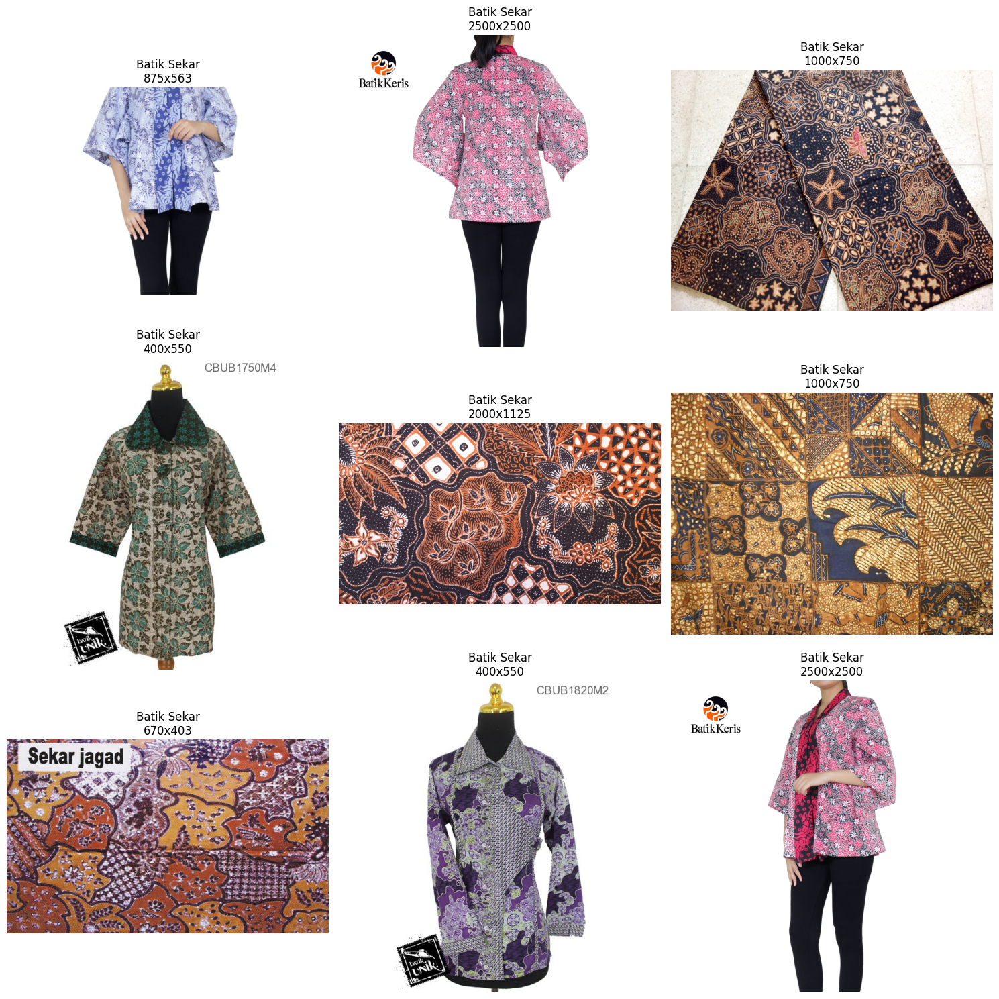

In [32]:
display_images_with_dimensions(1, 'Batik Sekar')


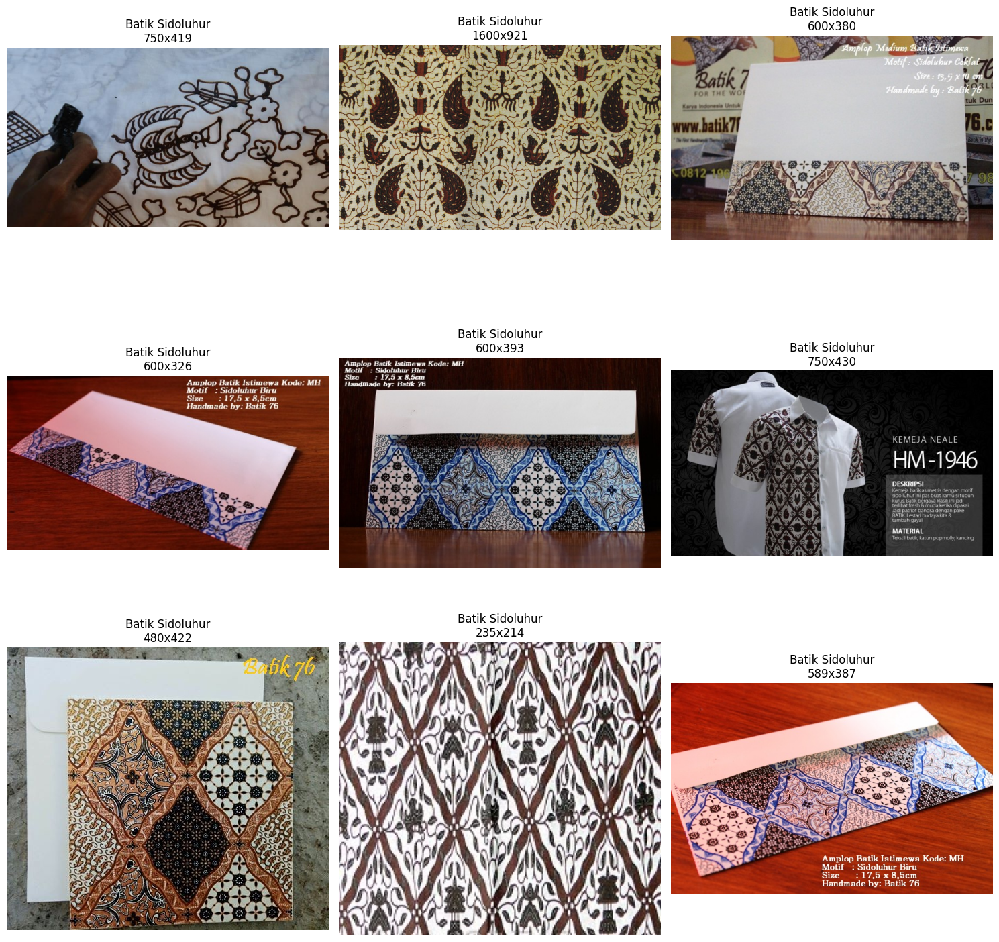

In [33]:
display_images_with_dimensions(2, 'Batik Sidoluhur')

In [34]:
# Function to resize images to 256x256
def resize_image(image_path, size=(256, 256)):
    img = cv2.imread(image_path)
    if img is not None:
        resized_img = cv2.resize(img, size)
        return resized_img
    else:
        return None


Resized Image Dimension Statistics:
       height  width  channels
count   147.0  147.0     147.0
mean    256.0  256.0       3.0
std       0.0    0.0       0.0
min     256.0  256.0       3.0
25%     256.0  256.0       3.0
50%     256.0  256.0       3.0
75%     256.0  256.0       3.0
max     256.0  256.0       3.0


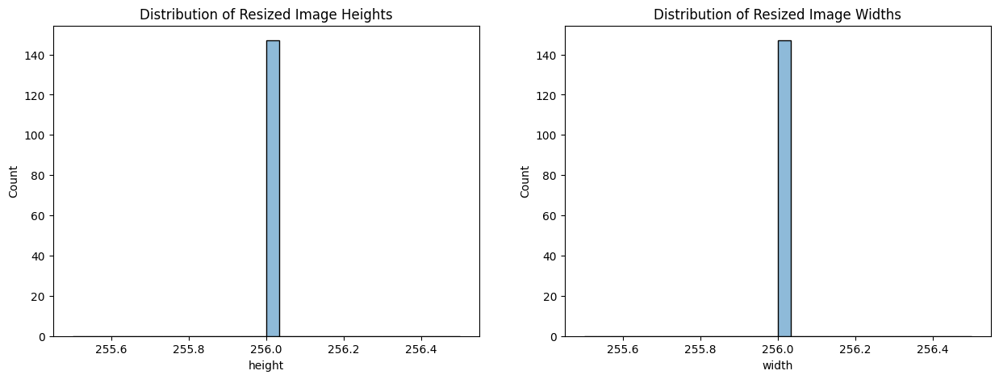

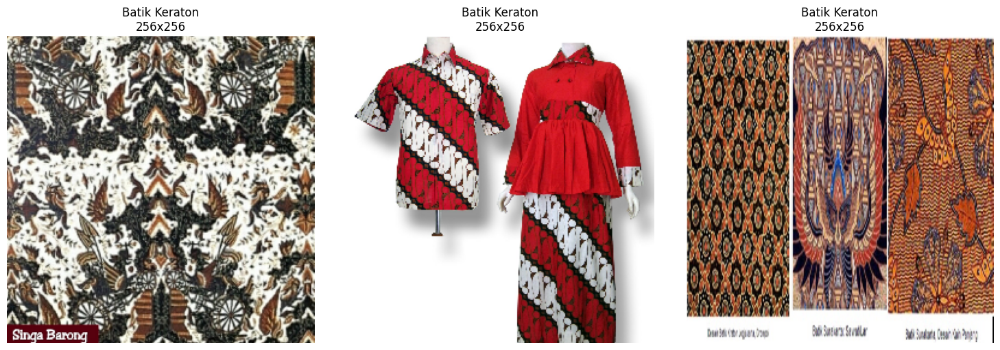

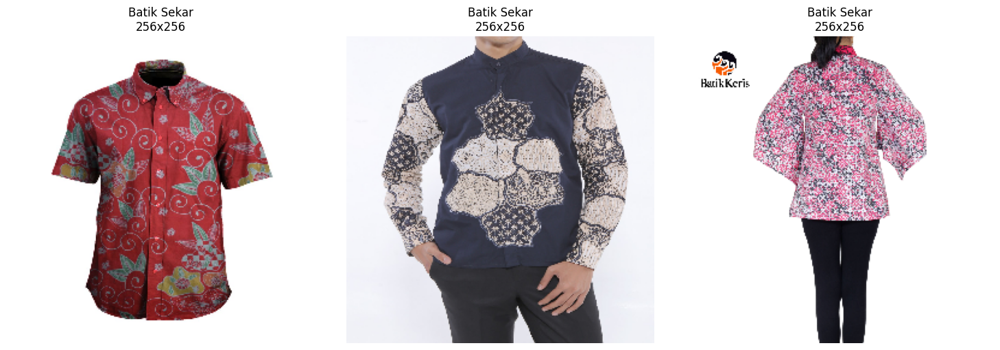

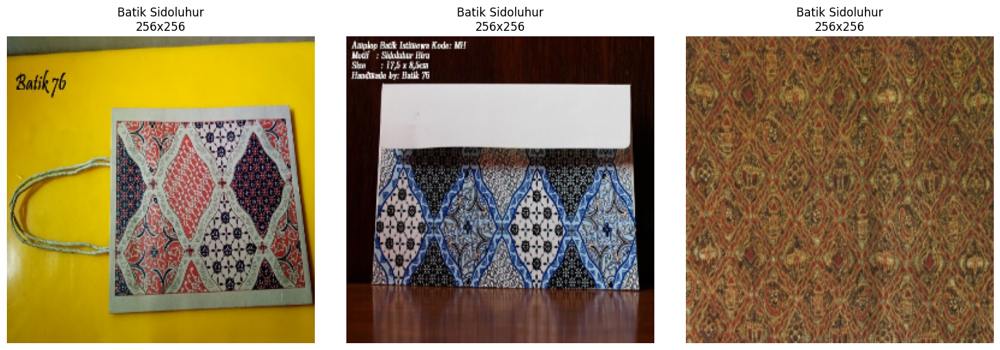

In [35]:
# Collect resized images and their dimensions
resized_images = [resize_image(path) for path in df['images']]
resized_dimensions = [(img.shape[0], img.shape[1], img.shape[2]) for img in resized_images if img is not None]
df_resized_dimensions = pd.DataFrame(resized_dimensions, columns=['height', 'width', 'channels'])

# Display basic statistics including the number of channels
print("\nResized Image Dimension Statistics:")
print(df_resized_dimensions.describe())

# Display basic statistics including the number of channels
plt.figure(figsize=(15, 5))

plt.subplot(1, 2, 1)
sns.histplot(df_resized_dimensions['height'], kde=True, bins=30)
plt.title('Distribution of Resized Image Heights')

plt.subplot(1, 2, 2)
sns.histplot(df_resized_dimensions['width'], kde=True, bins=30)
plt.title('Distribution of Resized Image Widths')

plt.show()

# Visualize resized images and their dimensions
def display_resized_images_with_dimensions(df, label, title):
    sample_images = df[df['label'] == label]['images'].sample(3)
    plt.figure(figsize=(15, 5))
    for idx, img_path in enumerate(sample_images):
        img = resize_image(img_path)
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        height, width = img.shape[:2]
        plt.subplot(1, 3, idx + 1)
        plt.imshow(img_rgb)
        plt.title(f'{title}\n{width}x{height}')
        plt.axis('off')
    plt.tight_layout()
    plt.show()


# Display examples of resized images with dimensions
display_resized_images_with_dimensions(df, 0, 'Batik Keraton')
display_resized_images_with_dimensions(df, 1, 'Batik Sekar')
display_resized_images_with_dimensions(df, 2, 'Batik Sidoluhur')

Batik Keraton Samples:


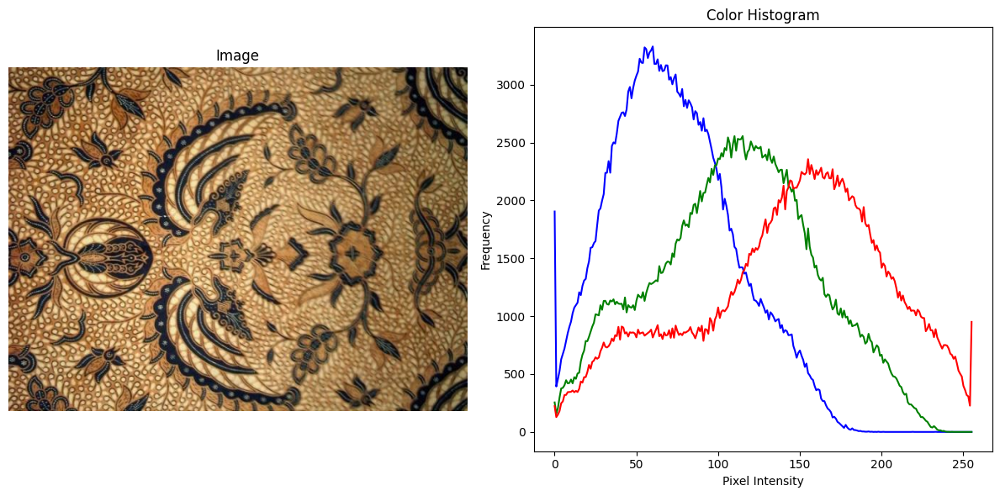

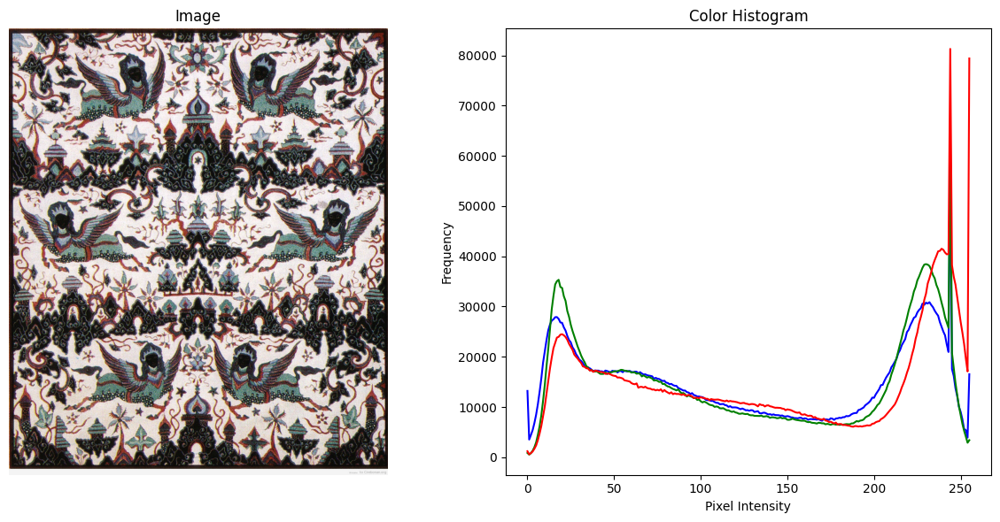

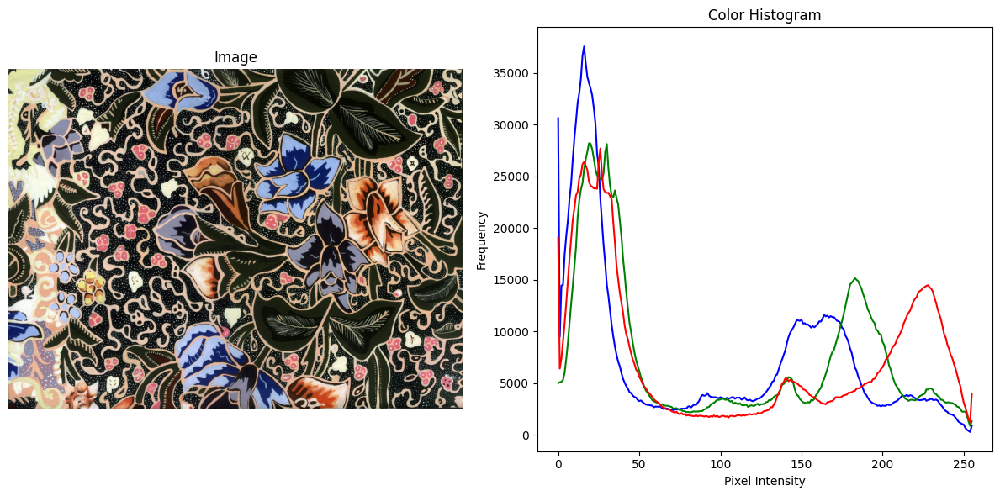

Batik Sekar Samples:


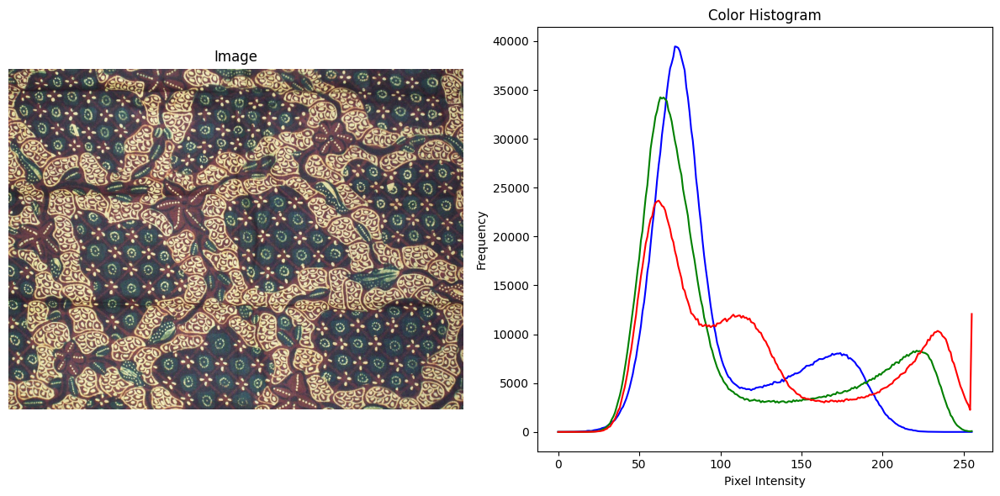

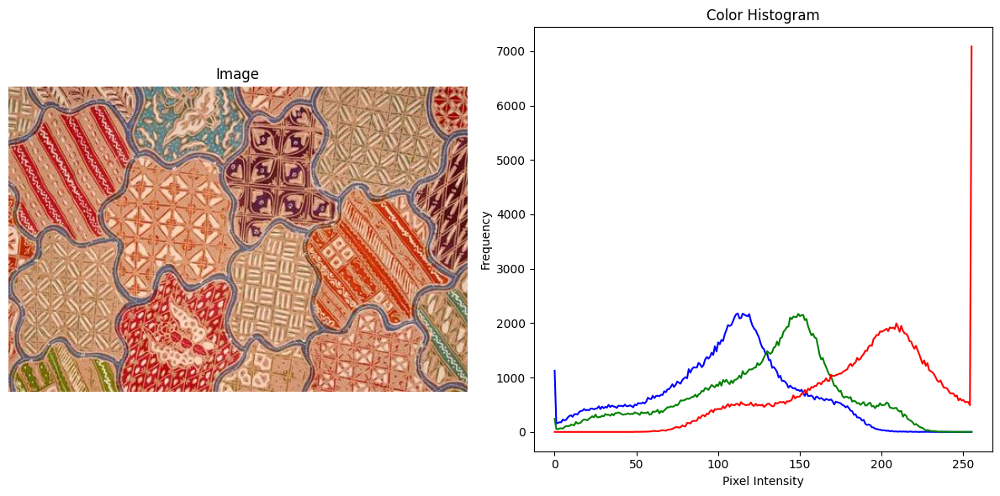

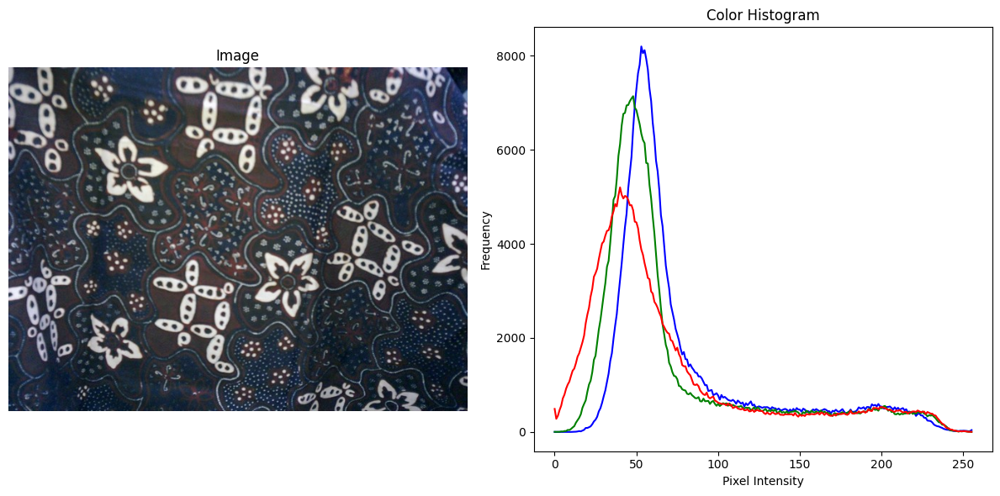

Batik Sidoluhur Samples:


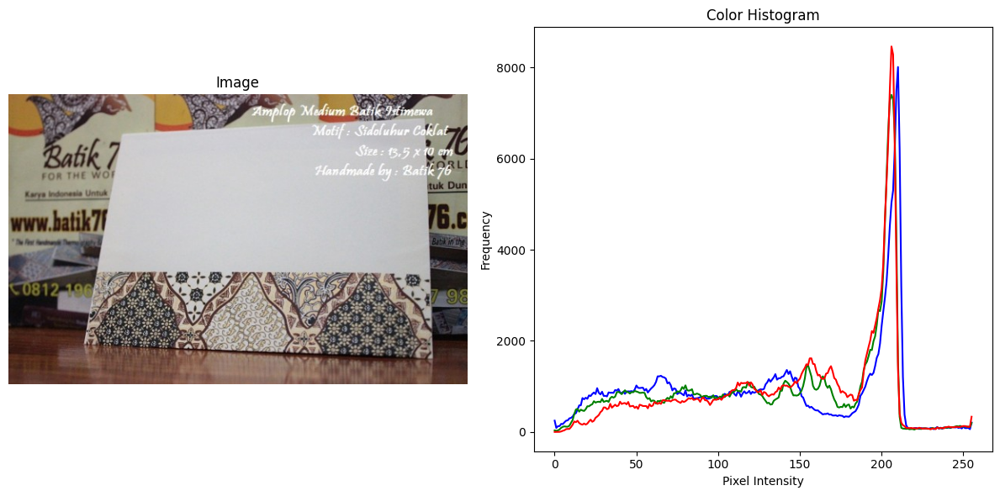

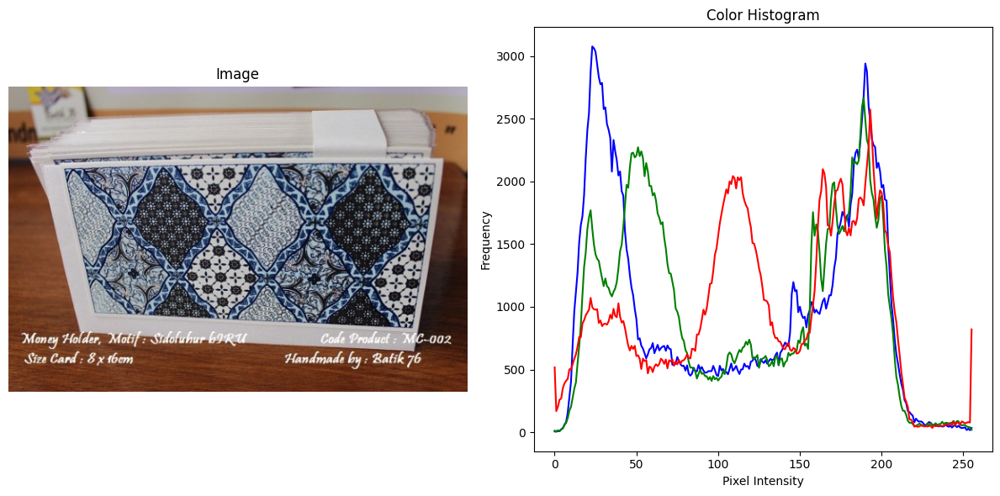

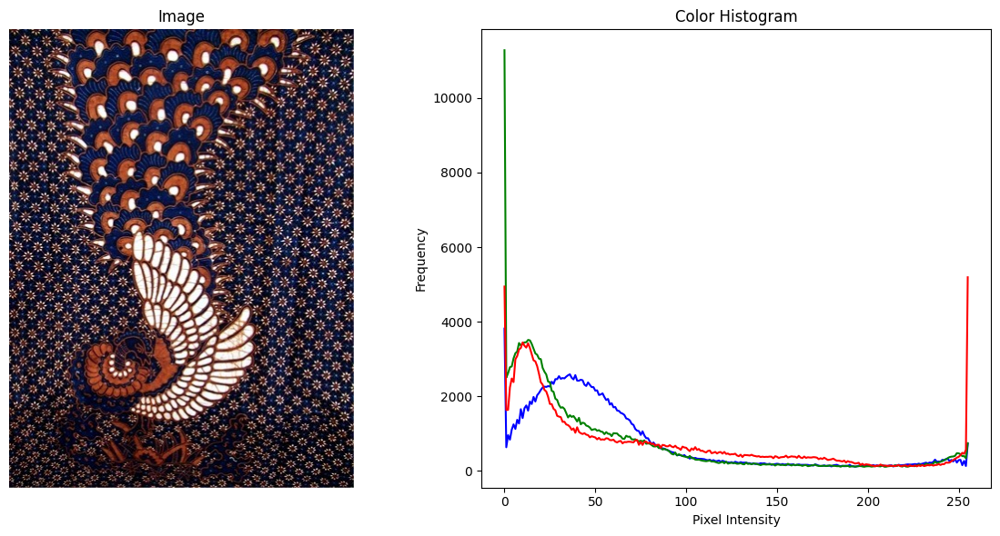

In [36]:
# Function to display image and color histogram
def plot_image_and_histogram(image_path):
    img = cv2.imread(image_path)
    if img is not None:
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        plt.figure(figsize=(12, 6))
        
        # Subplot for the image
        plt.subplot(1, 2, 1)
        plt.imshow(img_rgb)
        plt.title('Image')
        plt.axis('off')

        # Subplot for the color histogram
        plt.subplot(1, 2, 2)
        colors = ('b', 'g', 'r')  # Colors: Blue, Green, Red
        for i, color in enumerate(colors):
            hist = cv2.calcHist([img], [i], None, [256], [0, 256])
            plt.plot(hist, color=color)
        plt.title('Color Histogram')
        plt.xlabel('Pixel Intensity')
        plt.ylabel('Frequency')
        
        plt.tight_layout()
        plt.show()

# Sample size for images from each class
sample_size = 3

# Select random samples from each batik class
keraton_samples = df[df['label'] == 0]['images'].sample(sample_size).tolist()
sekar_samples = df[df['label'] == 1]['images'].sample(sample_size).tolist()
sidoluhur_samples = df[df['label'] == 2]['images'].sample(sample_size).tolist()

# Display images and color histograms for each sample from each batik class
print("Batik Keraton Samples:")
for path in keraton_samples:
    plot_image_and_histogram(path)

print("Batik Sekar Samples:")
for path in sekar_samples:
    plot_image_and_histogram(path)

print("Batik Sidoluhur Samples:")
for path in sidoluhur_samples:
    plot_image_and_histogram(path)

### Modelling

In [37]:
# Split data into training and testing sets
train_df, test_df = train_test_split(df, test_size=0.2, random_state=42)

# Parameters
img_height, img_width = 256, 256
batch_size = 32

# Create data generators with data augmentation for training
train_datagen = ImageDataGenerator(
    rescale=1./255,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True
) # Training data will be augmented 

test_datagen = ImageDataGenerator(rescale=1./255)

# Convert labels to string if they are not already
train_df['label'] = train_df['label'].astype(str)
test_df['label'] = test_df['label'].astype(str)

# Data generators
train_generator = train_datagen.flow_from_dataframe(
    train_df,
    x_col='images',
    y_col='label',
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical'
)

test_generator = test_datagen.flow_from_dataframe(
    test_df,
    x_col='images',
    y_col='label',
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

# Access data from generators
images, labels = next(train_generator)
print(images.shape, labels.shape)

Found 117 validated image filenames belonging to 3 classes.
Found 30 validated image filenames belonging to 3 classes.
(32, 256, 256, 3) (32, 3)


### Model Creation

**Model from scratch**

In [38]:
# Model from Scratch
# Model VGG16

def vgg16_model(input_shape, num_classes):
    model = Sequential([
    
        # Block 1
        Conv2D(64, (3, 3), activation='relu', padding='same', input_shape=input_shape),
        Conv2D(64, (3, 3), activation='relu', padding='same'),
        MaxPooling2D((2, 2), strides=(2, 2)),

        # Block 2
        Conv2D(128, (3, 3), activation='relu', padding='same'),
        Conv2D(128, (3, 3), activation='relu', padding='same'),
        MaxPooling2D((2, 2), strides=(2, 2)),

        # Block 3
        Conv2D(256, (3, 3), activation='relu', padding='same'),
        Conv2D(256, (3, 3), activation='relu', padding='same'),
        Conv2D(256, (3, 3), activation='relu', padding='same'),
        MaxPooling2D((2, 2), strides=(2, 2)),

        # Block 4
        Conv2D(512, (3, 3), activation='relu', padding='same'),
        Conv2D(512, (3, 3), activation='relu', padding='same'),
        Conv2D(512, (3, 3), activation='relu', padding='same'),
        MaxPooling2D((2, 2), strides=(2, 2)),

        # Block 5
        Conv2D(512, (3, 3), activation='relu', padding='same'),
        Conv2D(512, (3, 3), activation='relu', padding='same'),
        Conv2D(512, (3, 3), activation='relu', padding='same'),
        MaxPooling2D((2, 2), strides=(2, 2)),

        # Flatten and dense layers
        Flatten(),
        Dense(4096, activation='relu'),
        Dense(4096, activation='relu'),
        Dense(num_classes, activation='softmax')
    ])
                  
    # Compile the model
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    
    return model

# Model VGG16
vgg16_model = vgg16_model((img_height, img_width, 3), num_classes=3)

# Summary of VGG16 model
print("VGG16 Model Summary:")
vgg16_model.summary()

VGG16 Model Summary:


Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_26 (Conv2D)              │ (None, 256, 256, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_27 (Conv2D)              │ (None, 256, 256, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_10 (MaxPooling2D) │ (None, 128, 128, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_28 (Conv2D)              │ (None, 128, 128, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_29 (Conv2D)              │ (None, 128, 128, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_11 (MaxPooling2D) │ (None, 64, 64, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_30 (Conv2D)              │ (None, 64, 64, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_31 (Conv2D)              │ (None, 64, 64, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_32 (Conv2D)              │ (None, 64, 64, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_12 (MaxPooling2D) │ (None, 32, 32, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_33 (Conv2D)              │ (None, 32, 32, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_34 (Conv2D)              │ (None, 32, 32, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_35 (Conv2D)              │ (None, 32, 32, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_13 (MaxPooling2D) │ (None, 16, 16, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_36 (Conv2D)              │ (None, 16, 16, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_37 (Conv2D)              │ (None, 16, 16, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_38 (Conv2D)              │ (None, 16, 16, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_14 (MaxPooling2D) │ (None, 8, 8, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_2 (Flatten)             │ (None, 32768)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 4096)           │   134,221,824 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 4096)           │    16,781,312 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ (None, 3)              │        12,291 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 165,730,115 (632.21 MB)

 Trainable params: 165,730,115 (632.21 MB)

 Non-trainable params: 0 (0.00 B)

In [39]:
# Callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=5, min_lr=1e-6)

# Train the VGG16 model with early stopping and learning rate reduction
train_vgg16_model = vgg16_model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // train_generator.batch_size,
    epochs=11, 
    validation_data=test_generator,
    validation_steps=test_generator.samples // test_generator.batch_size,
    callbacks=[early_stopping, reduce_lr]
)

Epoch 1/11
3/3 ━━━━━━━━━━━━━━━━━━━━ 152s 48s/step - accuracy: 0.3038 - loss: 7.8289 - val_accuracy: 0.2667 - val_loss: 1.1066 - learning_rate: 0.0010
Epoch 2/11
3/3 ━━━━━━━━━━━━━━━━━━━━ 58s 6s/step - accuracy: 0.3438 - loss: 1.0960 - val_accuracy: 0.2667 - val_loss: 1.1119 - learning_rate: 0.0010
Epoch 3/11
3/3 ━━━━━━━━━━━━━━━━━━━━ 138s 44s/step - accuracy: 0.3492 - loss: 1.2300 - val_accuracy: 0.3667 - val_loss: 1.1048 - learning_rate: 0.0010
Epoch 4/11
3/3 ━━━━━━━━━━━━━━━━━━━━ 58s 7s/step - accuracy: 0.3125 - loss: 1.0939 - val_accuracy: 0.2667 - val_loss: 1.1023 - learning_rate: 0.0010
Epoch 5/11
3/3 ━━━━━━━━━━━━━━━━━━━━ 153s 52s/step - accuracy: 0.3906 - loss: 1.0960 - val_accuracy: 0.2667 - val_loss: 1.1058 - learning_rate: 0.0010
Epoch 6/11
3/3 ━━━━━━━━━━━━━━━━━━━━ 44s 7s/step - accuracy: 0.2857 - loss: 1.1024 - val_accuracy: 0.2667 - val_loss: 1.1050 - learning_rate: 0.0010
Epoch 7/11
3/3 ━━━━━━━━━━━━━━━━━━━━ 153s 51s/step - accuracy: 0.3581 - loss: 1.0972 - val_accuracy: 0.2667

In [41]:
from sklearn.metrics import classification_report
# Predict using the VGG16 model on the testing data
y_pred_vgg16 = vgg16_model.predict(test_generator)
y_true_vgg16 = test_generator.classes

# Get the predicted classes with the highest probability values
y_pred_vgg16 = np.argmax(y_pred_vgg16, axis=1)

# Class names used in the dataset
class_names = list(test_generator.class_indices.keys())

# Print classification report
print("Classification Report for VGG16:")
print(classification_report(y_true_vgg16, y_pred_vgg16, target_names=class_names))


1/1 ━━━━━━━━━━━━━━━━━━━━ 13s 13s/step
Classification Report for VGG16:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00        11
           1       0.00      0.00      0.00        11
           2       0.27      1.00      0.42         8

    accuracy                           0.27        30
   macro avg       0.09      0.33      0.14        30
weighted avg       0.07      0.27      0.11        30



### Model after hyperparameter tuning

**First model parameter tuning**

In [42]:
# Model VGG16 Tuning Parameter

def vgg16_model_modified(input_shape, num_classes):
    model = Sequential([
    
        # Block 1
        Conv2D(64, (3, 3), activation='relu', padding='same', input_shape=input_shape),
        BatchNormalization(),
        Conv2D(64, (3, 3), activation='relu', padding='same'),
        BatchNormalization(),
        MaxPooling2D((2, 2), strides=(2, 2)),

        # Block 2
        Conv2D(128, (3, 3), activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D(128, (3, 3), activation='relu', padding='same'),
        BatchNormalization(),
        MaxPooling2D((2, 2), strides=(2, 2)),

        # Block 3
        Conv2D(256, (3, 3), activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D(256, (3, 3), activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D(256, (3, 3), activation='relu', padding='same'),
        BatchNormalization(),
        MaxPooling2D((2, 2), strides=(2, 2)),

        # Block 4
        Conv2D(512, (3, 3), activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D(512, (3, 3), activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D(512, (3, 3), activation='relu', padding='same'),
        BatchNormalization(),
        MaxPooling2D((2, 2), strides=(2, 2)),

        # Block 5
        Conv2D(512, (3, 3), activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D(512, (3, 3), activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D(512, (3, 3), activation='relu', padding='same'),
        BatchNormalization(),
        MaxPooling2D((2, 2), strides=(2, 2)),

        # Flatten and dense layers
        Flatten(),
        Dense(4096, activation='relu'),
        Dropout(0.5),
        Dense(4096, activation='relu'),
        Dropout(0.5),
        Dense(num_classes, activation='softmax')
    ])
                  
    # Compile the model
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    
    return model

# Creating a VGG16 model with tuned parameters
vgg16_model_modified = vgg16_model_modified((img_height, img_width, 3), num_classes=3)

# Summary dari VGG16 model
print("VGG16 Model Summary:")
vgg16_model_modified.summary()

VGG16 Model Summary:


Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_39 (Conv2D)              │ (None, 256, 256, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 256, 256, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_40 (Conv2D)              │ (None, 256, 256, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 256, 256, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_15 (MaxPooling2D) │ (None, 128, 128, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_41 (Conv2D)              │ (None, 128, 128, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 128, 128, 128)  │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_42 (Conv2D)              │ (None, 128, 128, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 128, 128, 128)  │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_16 (MaxPooling2D) │ (None, 64, 64, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_43 (Conv2D)              │ (None, 64, 64, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 64, 64, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_44 (Conv2D)              │ (None, 64, 64, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 64, 64, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_45 (Conv2D)              │ (None, 64, 64, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_6           │ (None, 64, 64, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_17 (MaxPooling2D) │ (None, 32, 32, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_46 (Conv2D)              │ (None, 32, 32, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_7           │ (None, 32, 32, 512)    │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_47 (Conv2D)              │ (None, 32, 32, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_8           │ (None, 32, 32, 512)    │         2,04

 Total params: 165,747,011 (632.27 MB)

 Trainable params: 165,738,563 (632.24 MB)

 Non-trainable params: 8,448 (33.00 KB)

In [43]:
# Callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=5, min_lr=1e-6)

# Train the VGG16 model with early stopping and learning rate reduction
train_vgg16_model_mod = vgg16_model_modified.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // train_generator.batch_size,
    epochs=200,  # high number of epochs as early stopping will stop training when appropriate
    validation_data=test_generator,
    validation_steps=test_generator.samples // test_generator.batch_size,
    callbacks=[early_stopping, reduce_lr]
)

Epoch 1/200
3/3 ━━━━━━━━━━━━━━━━━━━━ 170s 59s/step - accuracy: 0.3294 - loss: 90.3421 - val_accuracy: 0.3667 - val_loss: 274.2007 - learning_rate: 0.0010
Epoch 2/200
3/3 ━━━━━━━━━━━━━━━━━━━━ 81s 7s/step - accuracy: 0.2812 - loss: 238.1292 - val_accuracy: 0.3667 - val_loss: 1454.6495 - learning_rate: 0.0010
Epoch 3/200
3/3 ━━━━━━━━━━━━━━━━━━━━ 158s 50s/step - accuracy: 0.3588 - loss: 136.2451 - val_accuracy: 0.3667 - val_loss: 11930.3682 - learning_rate: 0.0010
Epoch 4/200
3/3 ━━━━━━━━━━━━━━━━━━━━ 156s 50s/step - accuracy: 0.3895 - loss: 43.7999 - val_accuracy: 0.2667 - val_loss: 10266.7451 - learning_rate: 0.0010
Epoch 6/200
3/3 ━━━━━━━━━━━━━━━━━━━━ 64s 6s/step - accuracy: 0.4062 - loss: 46.4627 - val_accuracy: 0.2667 - val_loss: 6140.0469 - learning_rate: 0.0010
Epoch 7/200
3/3 ━━━━━━━━━━━━━━━━━━━━ 192s 68s/step - accuracy: 0.4284 - loss: 25.3607 - val_accuracy: 0.2667 - val_loss: 437.3389 - learning_rate: 1.0000e-04
Epoch 8/200
3/3 ━━━━━━━━━━━━━━━━━━━━ 49s 7s/step - accuracy: 0.4286 

In [44]:
from sklearn.metrics import classification_report
# Predict using the VGG16 model on the test data
y_pred_vgg16_mod = vgg16_model_modified.predict(test_generator)
y_true_vgg16_mod = test_generator.classes

# Get the predicted class with the highest probability
y_pred_vgg16_mod = np.argmax(y_pred_vgg16_mod, axis=1)

# Class names used in the dataset
class_names = list(test_generator.class_indices.keys())

# Print classification report
print("Classification Report for VGG16:")
print(classification_report(y_true_vgg16_mod, y_pred_vgg16_mod, target_names=class_names))


1/1 ━━━━━━━━━━━━━━━━━━━━ 13s 13s/step
Classification Report for VGG16:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00        11
           1       0.37      1.00      0.54        11
           2       0.00      0.00      0.00         8

    accuracy                           0.37        30
   macro avg       0.12      0.33      0.18        30
weighted avg       0.13      0.37      0.20        30



**Second parameter tuning model**

In [45]:
# Model VGG16 Tuning Parameter

def vgg16_model_modified2(input_shape, num_classes):
    model = Sequential([
    
        # Block 1
        Conv2D(64, (3, 3), activation='relu', padding='same', input_shape=input_shape),
        BatchNormalization(),
        Conv2D(64, (3, 3), activation='relu', padding='same'),
        BatchNormalization(),
        MaxPooling2D((2, 2), strides=(2, 2)),

        # Block 2
        Conv2D(128, (3, 3), activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D(128, (3, 3), activation='relu', padding='same'),
        BatchNormalization(),
        MaxPooling2D((2, 2), strides=(2, 2)),

        # Block 3
        Conv2D(256, (3, 3), activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D(256, (3, 3), activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D(256, (3, 3), activation='relu', padding='same'),
        BatchNormalization(),
        MaxPooling2D((2, 2), strides=(2, 2)),

        # Block 4
        Conv2D(512, (3, 3), activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D(512, (3, 3), activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D(512, (3, 3), activation='relu', padding='same'),
        BatchNormalization(),
        MaxPooling2D((2, 2), strides=(2, 2)),

        # Block 5
        Conv2D(512, (3, 3), activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D(512, (3, 3), activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D(512, (3, 3), activation='relu', padding='same'),
        BatchNormalization(),
        MaxPooling2D((2, 2), strides=(2, 2)),

        # Flatten and dense layers
        Flatten(),
        Dense(4096, activation='relu'),
        Dropout(0.5),
        Dense(4096, activation='relu'),
        Dropout(0.5),
        Dense(num_classes, activation='softmax')
    ])
                  
    # Compile the model
    model.compile(optimizer='SGD', loss='categorical_crossentropy', metrics=['accuracy'])
    
    return model

# Create VGG16 model
vgg16_model_modified2 = vgg16_model_modified2((img_height, img_width, 3), num_classes=3)

# Print summary of VGG16 model
print("VGG16 Model Summary:")
vgg16_model_modified2.summary()

VGG16 Model Summary:


Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_52 (Conv2D)              │ (None, 256, 256, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_13          │ (None, 256, 256, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_53 (Conv2D)              │ (None, 256, 256, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_14          │ (None, 256, 256, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_20 (MaxPooling2D) │ (None, 128, 128, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_54 (Conv2D)              │ (None, 128, 128, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_15          │ (None, 128, 128, 128)  │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_55 (Conv2D)              │ (None, 128, 128, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_16          │ (None, 128, 128, 128)  │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_21 (MaxPooling2D) │ (None, 64, 64, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_56 (Conv2D)              │ (None, 64, 64, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_17          │ (None, 64, 64, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_57 (Conv2D)              │ (None, 64, 64, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_18          │ (None, 64, 64, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_58 (Conv2D)              │ (None, 64, 64, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_19          │ (None, 64, 64, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_22 (MaxPooling2D) │ (None, 32, 32, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_59 (Conv2D)              │ (None, 32, 32, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_20          │ (None, 32, 32, 512)    │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_60 (Conv2D)              │ (None, 32, 32, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_21          │ (None, 32, 32, 512)    │         2,04

 Total params: 165,747,011 (632.27 MB)

 Trainable params: 165,738,563 (632.24 MB)

 Non-trainable params: 8,448 (33.00 KB)

In [46]:
# Callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=5, min_lr=1e-6)

# Training the VGG16 model with early stopping and learning rate reduction
train_vgg16_model_mod2 = vgg16_model_modified2.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // train_generator.batch_size,
    epochs=11, 
    validation_data=test_generator,
    validation_steps=test_generator.samples // test_generator.batch_size,
    callbacks=[early_stopping, reduce_lr]
)

Epoch 1/11
3/3 ━━━━━━━━━━━━━━━━━━━━ 196s 68s/step - accuracy: 0.2357 - loss: 17.1114 - val_accuracy: 0.3667 - val_loss: 451.1996 - learning_rate: 0.0100
Epoch 2/11
3/3 ━━━━━━━━━━━━━━━━━━━━ 47s 7s/step - accuracy: 0.3810 - loss: 25.0484 - val_accuracy: 0.3667 - val_loss: 37.4824 - learning_rate: 0.0100
Epoch 3/11
3/3 ━━━━━━━━━━━━━━━━━━━━ 155s 58s/step - accuracy: 0.3245 - loss: 4.0808 - val_accuracy: 0.3667 - val_loss: 117.3304 - learning_rate: 0.0100
Epoch 4/11
3/3 ━━━━━━━━━━━━━━━━━━━━ 65s 7s/step - accuracy: 0.3438 - loss: 3.4559 - val_accuracy: 0.3667 - val_loss: 64.2460 - learning_rate: 0.0100
Epoch 5/11
3/3 ━━━━━━━━━━━━━━━━━━━━ 206s 54s/step - accuracy: 0.5817 - loss: 2.4039 - val_accuracy: 0.3667 - val_loss: 59.6030 - learning_rate: 0.0100
Epoch 6/11
3/3 ━━━━━━━━━━━━━━━━━━━━ 64s 7s/step - accuracy: 0.5000 - loss: 2.1670 - val_accuracy: 0.3667 - val_loss: 46.4030 - learning_rate: 0.0100
Epoch 7/11
3/3 ━━━━━━━━━━━━━━━━━━━━ 189s 49s/step - accuracy: 0.5002 - loss: 1.7738 - val_accura

In [47]:
from sklearn.metrics import classification_report
# Predictions using the VGG16 model on the test data
y_pred_vgg16_mod2 = vgg16_model_modified2.predict(test_generator)
y_true_vgg16_mod2 = test_generator.classes

# Get the predicted class with the highest probability
y_pred_vgg16_mod2 = np.argmax(y_pred_vgg16_mod2, axis=1)

# Class names used in the dataset
class_names = list(test_generator.class_indices.keys())

# Print classification report
print("Classification Report for VGG16:")
print(classification_report(y_true_vgg16_mod2, y_pred_vgg16_mod2, target_names=class_names))


1/1 ━━━━━━━━━━━━━━━━━━━━ 32s 32s/step
Classification Report for VGG16:
              precision    recall  f1-score   support

           0       0.37      1.00      0.54        11
           1       0.00      0.00      0.00        11
           2       0.00      0.00      0.00         8

    accuracy                           0.37        30
   macro avg       0.12      0.33      0.18        30
weighted avg       0.13      0.37      0.20        30



### Model with fewer than 10M parameters

In [49]:
from keras.layers import Conv2D, BatchNormalization, ReLU, Input, Dense, GlobalAveragePooling2D
from keras.models import Model
# Model with fewer than 10M parameters
def mobilenetv2_block(inputs, filters, kernel_size, strides, alpha=1.0):
    # Function to create a MobileNet block without DepthwiseConv2D
    filters = int(filters * alpha)
    x = Conv2D(filters, kernel_size, strides=strides, padding='same')(inputs)
    x = BatchNormalization()(x)
    x = ReLU(6.)(x)
    return x

def create_mobilenet(input_shape, num_classes, alpha=1.0):
    # Function to create a MobileNet model
    inputs = Input(shape=input_shape)
    
    # Initial convolutional layer
    x = Conv2D(32, (3, 3), padding='same', strides=(2, 2))(inputs)  # Changed number of filters to 32
    x = BatchNormalization()(x)
    x = ReLU(6.)(x)
    
    # Define MobileNet blocks 
    x = mobilenetv2_block(x, 32, (3, 3), strides=(1, 1), alpha=alpha)
    x = mobilenetv2_block(x, 64, (3, 3), strides=(2, 2), alpha=alpha)
    x = mobilenetv2_block(x, 64, (3, 3), strides=(1, 1), alpha=alpha)
    x = mobilenetv2_block(x, 128, (3, 3), strides=(2, 2), alpha=alpha)
    x = mobilenetv2_block(x, 128, (3, 3), strides=(1, 1), alpha=alpha)
    x = mobilenetv2_block(x, 256, (3, 3), strides=(2, 2), alpha=alpha)
    
    # Create 3 additional blocks with 256 filters and strides (1,1)
    for _ in range(3):
        x = mobilenetv2_block(x, 256, (3, 3), strides=(1, 1), alpha=alpha)
        
    x = mobilenetv2_block(x, 512, (3, 3), strides=(2, 2), alpha=alpha)
    x = mobilenetv2_block(x, 512, (3, 3), strides=(1, 1), alpha=alpha)
    
    # Global average pooling and output layer
    x = GlobalAveragePooling2D()(x)
    outputs = Dense(num_classes, activation='softmax')(x)
    
    # Create model
    model = Model(inputs, outputs)
    
    return model

# Define input_shape and num_classes
input_shape = (256, 256, 3)
num_classes = 3

# Initialize MobileNet model
mobilenetv2_model = create_mobilenet(input_shape, num_classes, alpha=1.0)

# Compile the model
mobilenetv2_model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Define callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=5, min_lr=1e-6)

# Print summary of MobileNet model
print("MobileNet Model Summary:")
mobilenetv2_model.summary()


MobileNet Model Summary:


Model: "functional_6"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_6 (InputLayer)      │ (None, 256, 256, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_66 (Conv2D)              │ (None, 128, 128, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_27          │ (None, 128, 128, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu (ReLU)                    │ (None, 128, 128, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_67 (Conv2D)              │ (None, 128, 128, 32)   │         9,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_28          │ (None, 128, 128, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_1 (ReLU)                  │ (None, 128, 128, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_68 (Conv2D)              │ (None, 64, 64, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_29          │ (None, 64, 64, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_2 (ReLU)                  │ (None, 64, 64, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_69 (Conv2D)              │ (None, 64, 64, 64)     │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_30          │ (None, 64, 64, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_3 (ReLU)                  │ (None, 64, 64, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_70 (Conv2D)              │ (None, 32, 32, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_31          │ (None, 32, 32, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_4 (ReLU)                  │ (None, 32, 32, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_71 (Conv2D)              │ (None, 32, 32, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_32          │ (None, 32, 32, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_5 (ReLU)                  │ (None, 32, 32, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_72 (Conv2D)              │ (None, 16, 16, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_33          │ (None, 16, 16, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼─────────────

 Total params: 5,903,907 (22.52 MB)

 Trainable params: 5,898,915 (22.50 MB)

 Non-trainable params: 4,992 (19.50 KB)

In [50]:
# Training the MobileNet model with early stopping and learning rate reduction
train_mobilenetv2 = mobilenetv2_model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // train_generator.batch_size,
    epochs=200,  # high number of epochs due to early stopping
    validation_data=test_generator,
    validation_steps=test_generator.samples // test_generator.batch_size,
    callbacks=[early_stopping, reduce_lr]
)


Epoch 1/200
3/3 ━━━━━━━━━━━━━━━━━━━━ 30s 6s/step - accuracy: 0.3112 - loss: 2.4009 - val_accuracy: 0.3000 - val_loss: 1.1008 - learning_rate: 0.0010
Epoch 2/200
3/3 ━━━━━━━━━━━━━━━━━━━━ 4s 784ms/step - accuracy: 0.1905 - loss: 3.2659 - val_accuracy: 0.3667 - val_loss: 1.0918 - learning_rate: 0.0010
Epoch 3/200
3/3 ━━━━━━━━━━━━━━━━━━━━ 18s 5s/step - accuracy: 0.3802 - loss: 1.8716 - val_accuracy: 0.3667 - val_loss: 1.3335 - learning_rate: 0.0010
Epoch 4/200
3/3 ━━━━━━━━━━━━━━━━━━━━ 5s 992ms/step - accuracy: 0.6190 - loss: 1.0133 - val_accuracy: 0.3667 - val_loss: 1.5052 - learning_rate: 0.0010
Epoch 5/200
3/3 ━━━━━━━━━━━━━━━━━━━━ 36s 5s/step - accuracy: 0.4720 - loss: 1.0740 - val_accuracy: 0.3667 - val_loss: 1.8390 - learning_rate: 0.0010
Epoch 6/200
3/3 ━━━━━━━━━━━━━━━━━━━━ 5s 766ms/step - accuracy: 0.5625 - loss: 0.9224 - val_accuracy: 0.3667 - val_loss: 1.8342 - learning_rate: 0.0010
Epoch 7/200
3/3 ━━━━━━━━━━━━━━━━━━━━ 35s 4s/step - accuracy: 0.5558 - loss: 0.9236 - val_accuracy: 0

In [51]:
from sklearn.metrics import classification_report
# Predict labels for test data
y_pred_mobilenet = mobilenetv2_model.predict(test_generator)
y_true_mobilenet = test_generator.classes

# Convert predictions from probabilities to class labels
y_pred_mobilenet = np.argmax(y_pred_mobilenet, axis=1)

# Get class names
class_names = list(test_generator.class_indices.keys())

# Generate and print classification report
print("Classification Report for MobileNetV2:")
print(classification_report(y_true_mobilenet, y_pred_mobilenet, target_names=class_names))

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
Classification Report for MobileNetV2:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00        11
           1       0.33      0.55      0.41        11
           2       0.36      0.50      0.42         8

    accuracy                           0.33        30
   macro avg       0.23      0.35      0.28        30
weighted avg       0.22      0.33      0.26        30



### Plotting 

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


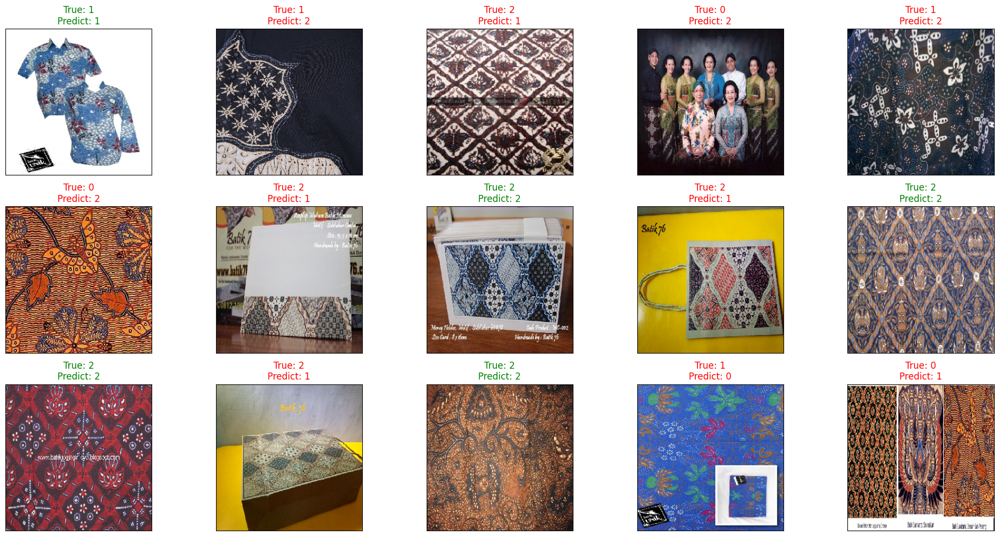

In [52]:
import numpy as np
import matplotlib.pyplot as plt

# Take one batch of data from test_generator
batch = next(test_generator)
images, labels = batch

# Predictions using the MobileNetV2 model
y_pred_mobilenet = mobilenetv2_model.predict(images)
y_pred_labels = np.argmax(y_pred_mobilenet, axis=1)

# Class names used in the dataset
class_names = list(test_generator.class_indices.keys())

# Select random samples for visualization
random_selection = np.random.choice(len(images), 15, replace=False)

fig = plt.figure(figsize=(20, 10))

for i, idx in enumerate(random_selection):
    image = images[idx]
    true_label = labels[idx]
    pred_label = y_pred_labels[idx]
    
    ax = fig.add_subplot(3, 5, i + 1, xticks=[], yticks=[])
    
    # If the image has more than 3 channels (e.g., alpha channel), take only the first 3 channels
    if image.shape[2] > 3:
        image = image[:, :, :3]
    
    # Convert from float to uint8
    image = (image * 255).astype('uint8')
    
    ax.imshow(image)
    ax.set_title('True: {}\nPredict: {}'.format(class_names[np.argmax(true_label)], class_names[pred_label]),
                 color=("green" if np.argmax(true_label) == pred_label else "red"), fontsize=12)

plt.tight_layout()
plt.show()


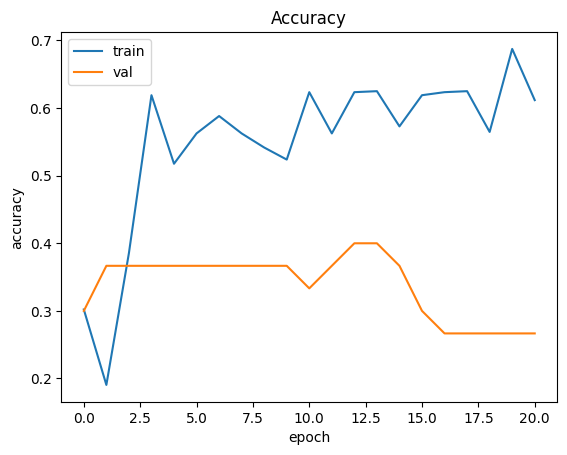

In [53]:
import matplotlib.pyplot as plt

# Retrieve the training history of the MobileNetV2 model
train_accuracy = train_mobilenetv2.history['accuracy']
val_accuracy = train_mobilenetv2.history['val_accuracy']

plt.plot(train_accuracy, label='train')
plt.plot(val_accuracy, label='val')
plt.title('Accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend()
plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 13s 13s/step


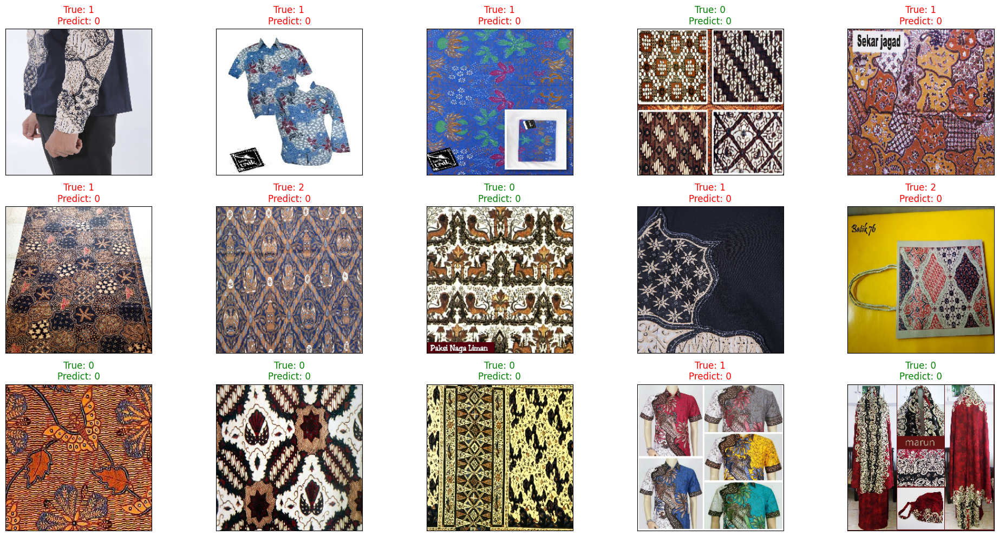

In [54]:
import numpy as np
import matplotlib.pyplot as plt

# Retrieve one batch of data from test_generator
batch = next(test_generator)
images, labels = batch

# Predictions using the modified VGG16 model
y_pred_vgg16 = vgg16_model_modified2.predict(images)
y_pred_labels = np.argmax(y_pred_vgg16, axis=1)

# Class names used in the dataset
class_names = list(test_generator.class_indices.keys())

# Select random samples for visualization
random_selection = np.random.choice(len(images), 15, replace=False)

fig = plt.figure(figsize=(20, 10))

for i, idx in enumerate(random_selection):
    image = images[idx]
    true_label = labels[idx]
    pred_label = y_pred_labels[idx]
    
    ax = fig.add_subplot(3, 5, i + 1, xticks=[], yticks=[])
    
    # If the image has more than 3 channels (e.g., alpha channel), take only the first 3 channels
    if image.shape[2] > 3:
        image = image[:, :, :3]
    
    # Konversi dari float ke uint8
    image = (image * 255).astype('uint8')
    
    ax.imshow(image)
    ax.set_title('True: {}\nPredict: {}'.format(class_names[np.argmax(true_label)], class_names[pred_label]),
                 color=("green" if np.argmax(true_label) == pred_label else "red"), fontsize=12)

plt.tight_layout()
plt.show()


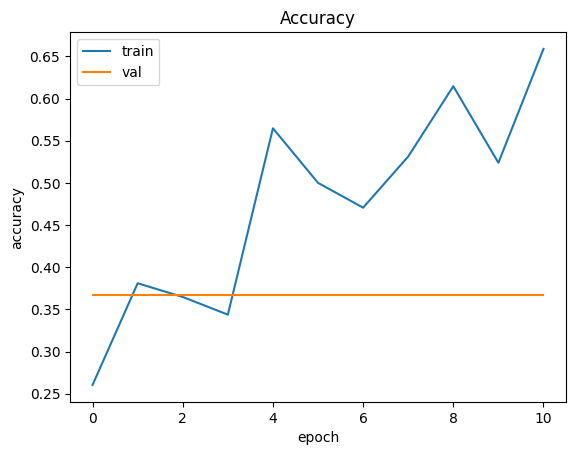

In [55]:
import matplotlib.pyplot as plt

# Retrieve the history from the model training
train_accuracy = train_vgg16_model_mod2.history['accuracy']
val_accuracy = train_vgg16_model_mod2.history['val_accuracy']

plt.plot(train_accuracy, label='train')
plt.title('Accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.plot(val_accuracy, label='val')
plt.legend()
plt.show()


Model 1 is the VGG16 model built from scratch with an accuracy of 0.27. Although it is unable to recognize classes 0 and 2, there is an improvement in class 1 during the first tuning attempt, where its accuracy reaches 0.37. In the second tuning attempt, the accuracy remains at 0.37, but this model starts to show recognition capability for class 0.

Model 2, MobileNetV2, shows an overall accuracy of 0.33. Although this model also struggles to recognize class 0, its ability to recognize classes 1 and 2 more consistently provides a slight advantage in terms of accuracy compared to Model 1.

Overall, both models face challenges in recognizing all classes effectively. The tuned Model 1 demonstrates a better distribution between precision and recall across all classes, even though its accuracy is slightly higher than that of Model 2. While Model 2 yields more consistent results, it still encounters difficulties in recognizing certain classes. Further adjustments are needed to enhance both models' abilities to recognize all classes more effectively.